In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib
import asciitable
import pyfits
import os
import physical_scale_func as phys
import re
import csv

# Set Up

In [2]:
PATH = '/Users/Roozbeh/Desktop/Work/Paper3/V2/'
candels = asciitable.read(PATH + 'SM/initial_conditions.csv')
singleSer = asciitable.read(PATH + 'SM/1comp.csv')

twoComp = pd.read_csv(PATH + 'SM/2comp.csv')
twoComp['Re_b_kpc'] = twoComp['Re_b_kpc']*np.sqrt(1-twoComp['e_b'])
twoComp['h_kpc'] = twoComp['h_kpc']*np.sqrt(1-twoComp['e_d'])

galfit_path = "/Users/Roozbeh/Desktop/Work/Old_Projects/Software/galfit"
header = ['Name','SN','z','mass','U','V','J','SF1_Quies0','SFH',\
          'X_b','Y_b','Re_b','Re_b_kpc','Mag_b','n_b','e_b','PA_b',\
          'X_d','Y_d','h','h_kpc','Mag_d','e_d','PA_d','BT',\
          'Re','Re_kpc','Mag','n','e','PA','sky_2ser','chi2_2ser','fitGoodness'] 

# Helper Functions 

### Galaxy as a Class 

In [3]:
class galaxy(object):
    """
    create a tag for each galaxy. 
    The tag includes the galaxy's:
    z / mass / SF_class / SFH and name
    """
    def __init__(self,name):
        self.name = name
        galaxy_info = candels[candels['Name'] == name]
        self.mass = round(galaxy_info['mass'][0],3)
        self.z = round(galaxy_info['z'][0],3)
        self.SF = galaxy_info['SF1_Quies0'][0]
        self.SFH = galaxy_info['SFH'][0]
        
    def getName(self):
        return self.name
        
    def getZ(self):
        return self.z

    def getMass(self):
        return self.mass
    
    def getSF(self):
        return self.SF
        
    def getSFH(self):
        return self.SFH
        
    def __str__(self):
        return '<' + self.name + ',SF=' + str(self.SF) + '>'

### Guessing the Initial Values 

In [4]:
def ic(galaxy, step=2, low0=1.5, high0=5.5, magzpt=26):
    """
    Purpose: estimating initial values for galfit 2comp fit
    """
    galaxyName = galaxy.getName()
    Re = singleSer[singleSer['Name'] == galaxyName]['re'][0]
    mag_t = singleSer[singleSer['Name'] == galaxyName]['mag'][0]

    # 1D profile is the key to finding good initial values
    galaxy1D = asciitable.read(PATH + '1D/' + galaxyName[:-3] + '1st.dat')

    # The estimation is done for different portion of the 1D profile
    # 
    estimates = []
    lo, hi = low0, low0 + step
    while hi <= high0:
        # Slicing a portion of the 1D profile
        profileSection = galaxy1D[np.array(lo*Re < galaxy1D['col1']) & \
                                     np.array(hi*Re > galaxy1D['col1'])]
        SMA = profileSection['col1']
        I = np.log(profileSection['col2'])
        q_d = 1-np.median(profileSection['col6'])
        PA_d = np.median(profileSection['col8'])
        PA_b = np.median(galaxy1D[np.array(0 < galaxy1D['col1']) & \
                                     np.array(1 > galaxy1D['col1'])]['col8'])
        
        # linear fit to the slice and finding R^2
        slope, inter = np.polyfit(SMA,I,1)
        R = np.corrcoef(SMA,I)[0,1]
        R2 = R*R
        ### In case the linear fit would fail --> r^2 = 0
        if np.isnan(R2):
            R2 = 0
        h = -(1/slope)
        ### Making sure that h is reasonble
        if h*1.679 < Re or np.isnan(h):
            print
            print 'Re Slice = ',lo, hi
            print 'measured h was smaller than Re or NaN'
            print 'h='+str(h) + '  Re=' + str(Re)
            h = Re
        elif h > 2*Re:
            print
            print 'Re Slice = ',lo, hi
            print 'measured h was larger than 2*Re'
            print 'h='+str(h) + '  Re=' + str(Re)

        Sigma0 = np.exp(inter)
        flux_d = 2*np.pi*(h**2)*Sigma0*q_d
        flux_t = 10**(.4*(26-mag_t))
        mag_d = -2.5*np.log10(flux_d) + 26
        
        ### Making sure that at least 20% of the light is in the bulge
        ### If it finds that B/T < 0.2 --> Set it to B/T = 0.2
        if mag_d - mag_t < 0.24 or np.isnan(mag_d):
            print
            print 'Re Slice = ',lo, hi
            print 'mag_d too high or NaN'  
            print 'mag_d=' + str(mag_d)
            mag_d = mag_t + 0.24
            mag_b = mag_t + 1.75
            flux_d = 10**(.4*(26-mag_d))
            flux_b = flux_t - flux_d
            
        ### If it finds that B/T > 0.8 --> Set it to B/T = 0.5
        elif mag_d - mag_t >= 1.75:
            print
            print 'Re Slice = ',lo, hi
            print 'mag_d too low  mag_d=' + str(mag_d)
            mag_d = mag_t + 0.75
            mag_b = mag_t + 0.75
            flux_d = 10**(.4*(26-mag_d))
            flux_b = flux_t - flux_d
        else:
            flux_d = 10**(.4*(26-mag_d))
            flux_b = flux_t - flux_d
            mag_b = -2.5*np.log10(flux_b) + magzpt
        BT = flux_b / flux_t
        
        estimates.append((round(R2,3), round(min(h,5),3), round(mag_d,3), round(1-q_d,3),\
                     round(PA_d,3), round(mag_b,3), round(PA_b,3), round(BT,3)))
        lo += step
        hi += step

    ### Finding the best estimate based on Only R^2 of the linear fits
    ### If there are more than one fit with max R^2 --> TAKE AVERAGE
    # B/T = 0.5
    mag_d = mag_t + 0.75
    mag_b = mag_t + 0.75
    estimates = np.array(estimates, dtype=[('R2',float), ("h",float), ("mag_d",float), ("e_d",float), \
                                           ("PA_d",float), ("mag_b",float),("PA_b",float),("BT",float)])
    
    try:
        BEST = estimates[estimates['R2'] == max(estimates['R2'])]
        if len(BEST) > 1:
            Best, Count = np.zeros(len(estimates[0])),0
            for bestie in BEST:
                Best = Best + np.array(list(bestie))
                Count += 1
            BEST = np.array(tuple(Best/Count),dtype=[('R2',float), ("h",float), ("mag_d",float), ("e_d",float), \
                                               ("PA_d",float), ("mag_b",float),("PA_b",float),("BT",float)])
    
    ### If all the linear fits have fialed --> Set it to B/T = 0.2
    except: 
        # B/T = 0.2
        #mag_d = mag_t + 0.24
        #mag_b = mag_t + 1.75
        # B/T = 0.5
        mag_d = mag_t + 0.75
        mag_b = mag_t + 0.75
        flux_d = 10**(.4*(26-mag_d))
        flux_b = flux_t - flux_d
        BT = flux_b / flux_t
        h = min(max(Re,10),5)
        BEST = np.array((lo, hi, round(R2,3), round(h,3), round(Sigma0,3), round(mag_d,3), round(mag_b,3), round(BT,3)),
                       dtype=[('lo',float),('hi',float), ('R2',float), ("h",float), ("Sigma",float), 
                              ("mag_d",float), ("mag_b",float), ("BT",float)])

    print 
    print 
    print '1D Estimates','h=' ,h, 'BT=', BT    
    return BEST

### Create the GALFIT 2comp Input File 

In [5]:
def create_readinFile(galaxy,re_B=1,n_B=1,step=2, low0=1.5,high0=6,
                      pixel_scale=0.06, label='2ser', magzpt=26, cat=singleSer):
    """
    creates the text file that can be fed to galfit
    """

    ## To be used by the catalogues entry, as well
    global re_b_fix, n_b_fix
    
    ######################################
    ##### Setting the initial values #####
    ######################################
    imageName = galaxy.getName()  
    ICs = ic(galaxy,step, low0,high0)
    galaxy = cat[cat['Name'] == imageName]
    galaxy = pd.DataFrame(galaxy)
    print make_float(galaxy['SF1_Quies0']),make_float(galaxy['re']), make_float(galaxy['n'])
    print imageName, 'SF1_Quie0: ' + str(make_float(galaxy['SF1_Quies0'])), \
    'Re (pix): ' + str(make_float(galaxy['re'])), 'n: ' + str(make_float(galaxy['n']))

    Re_b = re_B
    mag_b = make_float(ICs['mag_b'])
    n_b = n_B
    e_b = 0.2
    PA_b = make_float(ICs['PA_b'])
    # Disk initial values    
    h = make_float(ICs['h'])
    mag_d = make_float(ICs['mag_d'])
    e_d = make_float(ICs['e_d'])
    PA_d = make_float(ICs['PA_d'])
 
    ## Using lower/upper limits if the estimates are poor
    if h > 20:  h = 10
    if h < 5:  h = 5
    if mag_b > 25: mag_b = 25
    if mag_d > 25: mag_d = 25
    if mag_b < 18: mag_b = 18
    if mag_d < 18: mag_d = 18
    if e_d > 0.7: e_d = 0.6

    
    ####################################
    ###### Interactive IC Setting ######
    #################################### 
    re_b_fix = raw_input('Keeping Re_b fixed?: ')
    if re_b_fix.lower() == 'yes':
        re_b_fix = 0
    else:
        re_b_fix = 1
            
    n_b_fix = raw_input('Keeping n_b fixed?: ')
    if n_b_fix.lower() == 'yes':
        n_b_fix = 0
    else:
        n_b_fix = 1     
    
    sanity_check = raw_input('Happy with h:' + str(h) + ':  ')
    if sanity_check.lower() == 'no':
        h = raw_input('initial h? ')    
    
    
    ################################
    ###########  PSF  ############## 
    ################################
    if '_gn' in imageName: psf = 'gn_psf'
    elif '_gs' in imageName: psf = 'gs_psf'
    elif 'uds' in imageName: psf = 'uds_psf'
    elif 'cosmos' in imageName: psf = 'cosmos_psf'
    elif '_egs' in imageName: psf = 'egs_psf'


    img_size = len(pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')[0].data)
    feedme = open(PATH + 'Read/2comp/' + imageName[:-4] + '_' + label + '.read','w')

    feedme.writelines('================================================================================\n'
    'A) ' + PATH + 'Fits/Sample/FINE/' + imageName + '.fit ' + '                 # Output data image block \n' 
    'B) ' + PATH + 'Fits/2comp/' + imageName[:-4] + '_' + label + '.fit' + ' # Output data image block \n'
    'C) ' + PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_rms.fits' + '             # Sigma image name (made from data if blank or "none") \n'
    'D) ' + PATH + 'psf/' +  psf  +   '.fits' + '                       # Input PSF image and (optional) diffusion kernel \n'
    'E) 1                                                               # PSF fine sampling factor relative to data \n'
    'F) ' + PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_mm.fits' + '              # Bad pixel mask (FITS image or ASCII coord list) \n'
    'G) none                                                            # File with parameter constraints (ASCII file) \n'
    'H) 1  ' + str(img_size) + '   1  ' + str(img_size) + '     # Image region to fit (xmin xmax ymin ymax) \n'
    'I) ' + str(img_size) + '    ' + str(img_size) + '          # Size of the convolution box (x y) \n'
    'J)   ' + str(magzpt) +  '                                  # Magnitude photometric zeropoint \n'
    'K) ' + str(pixel_scale) + ' ' + str(pixel_scale) + '       # Plate scale (dx dy)   [arcsec per pixel] \n'
    'O) regular                                                 # Display type (regular, curses, both) \n'
    'P) 0                                                       # Options: 0=normal run; 1,2=make model/imgblock & quit \n\n'
    '0) sersic              # Object type\n'
    '1) ' + str(img_size/2 + 1) + ' ' + str(img_size/2) + ' 1  1          # Object coordinate  \n'
    '3) ' + str(mag_b) + '    1                                 # total magnitude \n'
    '4) ' + str(Re_b) + '   ' + str(re_b_fix) + '               # R_e    [Pixels] \n'
    '5) ' + str(n_b) + '    ' + str(n_b_fix) + '                # Sersic exponent (deVauc=4, expdisk=1) \n'
    '9) ' + str(1-e_b) + '    1                                 # axis ratio (b/a) \n'
    '10) ' + str(PA_b) + '    1                                 # position angle (PA)  [Degrees: Up=0, Left=90] \n'
    'Z) 0                                                       # Skip this model in output image?  (yes=1, no=0) \n\n'
    '0) expdisk              # Object type\n'
    '1) ' + str(img_size/2 + 1) + ' ' + str(img_size/2) + ' 1  1          # Object coordinate  \n'
    '3) ' + str(mag_d) + '    1                                   # total magnitude \n'
    '4) ' + str(h) + '     1                                   # R_e    [Pixels] \n'
    '9) ' + str(1-e_d) + '      1                                 # axis ratio (b/a) \n'
    '10) ' + str(PA_d) + '    1                                   # position angle (PA)  [Degrees: Up=0, Left=90] \n'
    'Z) 0                                                       # Skip this model in output image?  (yes=1, no=0) \n\n'
    '0) sky                                                     # Component type \n'
    '1) 0     1                                                 # Sky background at center of fitting region [ADUs] \n'
    '2) 0     1                                                 # dsky/dx (sky gradient in x)     [ADUs/pix] \n'
    '3) 0     1                                                 # dsky/dy (sky gradient in y)     [ADUs/pix] \n'
    'Z) 0                                                       # Skip this model in output image?  (yes=1, no=0) \n'
    )

    feedme.close()

    return

### Running Galfit

In [6]:
def run_galfit(galaxy,step=2, low0=1.5, high0 = 6,
               label='2ser',galfit_path = galfit_path):
    """
    simply runs galfit
    """
    imageName = galaxy.getName()
    print
    print
    print galaxy
    ReB = float(raw_input('Initial Re_bulge:  '))
    nB = float(raw_input('Initial n_bulge:  '))
    create_readinFile(galaxy,ReB,nB,step,low0,high0)
    os.system(galfit_path + '   ' + PATH + 'Read/2comp/' + imageName[:-4] + '_' + label + '.read')
    os.system('rm  ' + PATH + 'Read/2comp/' + imageName[:-4] + '_' + label + '.read') 
    os.system('mv galfit.01 ' + PATH + 'Read/2comp/' + imageName[:-4] + '_' + label + '.read')


### Create a Catalogue Entry 

In [7]:
def build_catalogue_entry(galaxy,label='2ser',cat=singleSer):
    """
    for building catalogue
    """
    
    ## They are set in create_readinFile function
    global re_b_fix, n_b_fix
    
    imageName = galaxy.getName()
    gal = cat[cat['Name'] == imageName]
    gal = pd.DataFrame(gal)

    # Info from 1comp results
    print make_float(gal['re'])
    Re = make_float(gal['re'])
    Re_kpc = make_float(gal['re_kpc'])
    Mag = make_float(gal['mag'])
    n = make_float(gal['n'])
    e = make_float(gal['e'])
    PA = make_float(gal['PA'])
    z, mass, SN = make_float(gal['z']), make_float(gal['mass']), make_float(gal['SN'])
    U, V, J = make_float(gal['U']), make_float(gal['V']), make_float(gal['J'])
    SF_class, SFH = make_float(gal['SF1_Quies0']), make_float(gal['SFH'])
    
    try:
        gal_output = open(PATH + 'Read/2comp/' + imageName[:-4] + '_' + label + '.read','r')
        twoSer = gal_output.readlines()
        gal_output.close()
        
        chi2_2ser = float(re.search(r'[\w\^\/]+\s=\s([\w.]+)', twoSer[3]).group(1))
        # bulge        
        x_b = float(re.search(r'([\w.]+)\s+([\w.]+)',twoSer[40]).group(1))
        y_b = float(re.search(r'([\w.]+)\s+([\w.]+)',twoSer[40]).group(2))
        mag_b = float(re.search(r'([\w.]+)\s+(1)',twoSer[41]).group(1))
        re_b = float(re.search(r'([\w.]+)\s+('+str(re_b_fix)+')',twoSer[42]).group(1))
        re_b_kpc =  physical_size(re_b,z)
        n_b = float(re.search(r'([\w.]+)\s+('+str(n_b_fix)+')',twoSer[43]).group(1))
        e_b = 1 - float(re.search(r'([\w.]+)\s+(1)',twoSer[47]).group(1))
        PA_b = float(re.search(r'([-\w.]+)\s+(1)',twoSer[48]).group(1))
        # disk
        x_d = float(re.search(r'([\w.]+)\s+([\w.]+)',twoSer[53]).group(1))
        y_d = float(re.search(r'([\w.]+)\s+([\w.]+)',twoSer[53]).group(2))
        mag_d = float(re.search(r'([\w.]+)\s+(1)',twoSer[54]).group(1))
        h = float(re.search(r'([\w.]+)\s+(1)',twoSer[55]).group(1))
        h_kpc =  physical_size(h,z)
        e_d = 1 - float(re.search(r'([\w.]+)\s+(1)',twoSer[60]).group(1))
        PA_d = float(re.search(r'([-\w.]+)\s+(1)',twoSer[61]).group(1))
        # Bulge to total ratio
        BtoT = 1/(pow(10,(float(mag_b)-float(mag_d))*.4)+1)
        #sky
        sky_2ser = float(re.search(r'([\w.-]+)\s+(1)',twoSer[66]).group(1))

        
        output= [imageName, SN, z, mass, U, V, J, SF_class, SFH] + \
                map(round3,[x_b, y_b, re_b, re_b_kpc, mag_b, n_b, e_b, PA_b]) + \
                map(round3,[x_d, y_d, h, h_kpc, mag_d, e_d, PA_d, BtoT]) + \
                map(round3,[Re, Re_kpc, Mag, n, e, PA]) + \
                [sky_2ser,chi2_2ser]
       
        print
        print 'GALFIT Estimates','BT=', BtoT, ' Re_bulge=', re_b, ' h=', h, ' n_bulge=', n_b 
        print 
        print 'Catalogue Entry'
        return output
        #catalogue.append(output)
        
    except:
        #raise Exception('GALFIT Failed To Fit A Model')
        print 'GALFIT Failed To Fit A Model'
        pass

### Update Catalogue 

In [8]:
def write_catalogue(data_list,CatName='2comp.csv'):
    """
    write the catalogue to a CSV file
    """
    currectCat = pd.read_csv(PATH + "SM/" + CatName)
    if data_list[0] in currectCat.Name.values:
        return
    models_results = open(PATH + "SM/" + CatName, "a")
    write_pattern = csv.writer(models_results)
    write_pattern.writerow(data_list)
    models_results.close() 

### Find The Best Fit 

In [9]:
def findBest(gal, step=2, low0=1.5,high0 = 6,label='2ser'):
    """
    finding the model fit based on different initial conditions, interactively
    """
    run_galfit(galaxy(gal),step, low0, high0)
    entry = build_catalogue_entry(galaxy(gal))
    
    ## Checking the GOODNESS of the fit
    os.system('ds9 -multiframe -scale log ' + PATH + 'Fits/2comp/' + gal[:-4] + '_' + label + '.fit &')        
    
    ## Using Surface Brightness Diagnostic
    construct_subComponent(gal)
    e0, PA0 = entry[-4], entry[-3]
    ellipse(gal,e0=e0,PA0=PA0,Type='galaxy')
    ellipse(gal,e0=e0,PA0=PA0,Type='model')
    ellipse(gal,e0=e0,PA0=PA0,Type='bulge')
    ellipse(gal,e0=e0,PA0=PA0,Type='disk')
    tdump(gal,Type='galaxy')
    tdump(gal,Type='model')
    tdump(gal,Type='bulge')
    tdump(gal,Type='disk')
    plot_diagnostic(gal)
    response = raw_input('Happy With Output? (yes/no):  ')
    
    if response.lower() == 'no':
        step = float(raw_input('step?  '))
        low0 = float(raw_input('low0?  '))
        high0 = float(raw_input('high0?  '))
        findBest(gal, step, low0, high0)
    elif response.lower() == 'yes':
        fitGoodness = raw_input('Goodness of the fit? (high/inter/low):  ')        
        note = raw_input('note:  ') 
        write_catalogue(list(build_catalogue_entry(galaxy(gal))) + [fitGoodness,note])
    else:
        raise 'Unknow Reponse (yes or no?)'

### Misc. Functions 

In [11]:
def round3(x): return round(x,3)

def make_float(parameter):
    try:
        return float(parameter[0])
    except:
        return float(parameter)

def physical_size(Re,z,pix_scale=0.06):
    return Re*phys.physical_scale(z)*pix_scale

# Diagnostic Graphs

### Constructing Image of Each Object: galaxy/model/bulge/disk 

In [12]:
def construct_subComponent(imageName, Directory='2comp'):
    """
    Create a FITS file which contains only Bulge or Disk component
    """
    
    # Finding the size of the image
    image_size = len(pyfits.open(PATH + 'Fits/' + Directory + '/' + imageName[:-3] + '2ser.fit')[2].data)    
    twoCompModel = pyfits.open(PATH + 'Fits/' + Directory + '/' + imageName[:-3] + '2ser.fit')
    
    # Creating the subcompents image
    os.system(galfit_path + ' -o3 ' + PATH + 'Read/' +  Directory + '/' + imageName[:-3] + '2ser.read')
    subComp = pyfits.open('subcomps.fits')
    
    #####################
    ###### GALAXY #######
    #####################
    if imageName[:-3] + '2ser_galaxy.fit' not in os.listdir(PATH  + 'Fits/' + Directory +'/'):        
        ZeroArray = np.zeros([image_size,image_size])
        canvas1 = pyfits.PrimaryHDU(ZeroArray)
        canvas_galaxy = canvas1.data
        canvas_galaxy += subComp[0].data - subComp[3].data
        canvas1.data = canvas_galaxy
        canvas1.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_galaxy.fit')

    ####################
    ###### Model #######
    ####################        
    if imageName[:-3] + '2ser_model.fit' in os.listdir(PATH  + 'Fits/' + Directory +'/'):
        # If there is already a model galaxy, we need to remove it first
        os.system('rm ' + PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_model.fit')
        
    ZeroArray = np.zeros([image_size,image_size])
    canvas2 = pyfits.PrimaryHDU(ZeroArray)
    canvas_model = canvas2.data
    canvas_model += twoCompModel[2].data - subComp[3].data
    canvas2.data = canvas_model
    canvas2.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_model.fit')

    ####################
    ###### Bulge #######
    #################### 
    if imageName[:-3] + '2ser_bulge.fit' in os.listdir(PATH  + 'Fits/' + Directory +'/'):
        # If there is already a bulge image, we need to remove it first
        os.system('rm ' + PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_bulge.fit')
        
    ZeroArray = np.zeros([image_size,image_size])
    canvas2 = pyfits.PrimaryHDU(ZeroArray)
    canvas_model = canvas2.data
    canvas_model += subComp[1].data
    canvas2.data = canvas_model
    canvas2.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_bulge.fit')
    
    ###################
    ###### Disk #######
    ################### 
    if imageName[:-3] + '2ser_disk.fit' in os.listdir(PATH  + 'Fits/' + Directory +'/'):
        # If there is already a disk image, we need to remove it first
        os.system('rm ' + PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_disk.fit')
        
    ZeroArray = np.zeros([image_size,image_size])
    canvas2 = pyfits.PrimaryHDU(ZeroArray)
    canvas_model = canvas2.data
    canvas_model += subComp[2].data
    canvas2.data = canvas_model
    canvas2.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_disk.fit')

### Constructing Surface Brightness Profile Using ELLIPSE   

In [13]:
def ellipse(imageName, e0, PA0, Type, Directory='2comp',\
            hold_e='yes', hold_PA='yes', magzpt=26, step_size=0.04):
    """
    Baically does what ELLIPSE/IRAF does but have limited options for editing
    """

    # Remove the result from the previouse run
    if imageName[:-3] + '2ser' + '_' + Type + '.bin' in os.listdir(PATH + '1D/'):
        os.system('rm ' + PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.bin')
        os.system('rm ' + PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.dat')
    
    # Creating the parameter file for ELLIPSE
    fp = open(PATH + '/Par/ellipse.par','r')
    ellipse_par = fp.readlines()
    fp.close()  

    if Type.lower() == 'galaxy': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_galaxy.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_galaxy.fit' + '\n'
    elif Type.lower() == 'model': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_model.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp//' + imageName[:-3] + '2ser_model.fit' + '\n'
    elif Type.lower() == 'bulge':
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_bulge.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_bulge.fit' + '\n'
    elif Type.lower() == 'disk':
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_disk.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_disk.fit' + '\n'
    elif Type.lower() == 'unconv':
        image_size = len(pyfits.open(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_unconv.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_unconv.fit' + '\n'
        
    ellipse_par[1] = 'ellipse.output = ' + PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.bin' + '\n'
    ellipse_par[2] = 'geompar.x0= ' + str(image_size/2) + '\n'
    ellipse_par[3] = 'geompar.y0= ' + str(image_size/2) + '\n'
    ellipse_par[4] = 'geompar.ellip0 = ' + str(e0) + '\n'
    ellipse_par[5] = 'geompar.pa0 = ' + str(PA0) + '\n'
    ellipse_par[6] = 'magpar.mag0 = ' + str(magzpt) + '\n'
    ellipse_par[7] = 'geompar.maxsma = ' + str(image_size/2) + '\n'
    ellipse_par[8] = 'controlpar.hellip = ' + str(hold_e) + '        \n'
    ellipse_par[9] = 'controlpar.hpa = ' + str(hold_PA) + '           \n'
    ellipse_par[10] = 'geompar.step = ' + str(step_size) + '          \n' 
   
    output = open(PATH + '/Par/ellipse' + imageName + '.par','w')
    output.writelines(ellipse_par)
    output.close()  
    
    # Running ELLIPSE
    os.system('/usr/stsci/stsci_iraf-3.14/stsdas/bin.macintel/x_isophote.e \
               ellipse @' + PATH + '/Par/ellipse' + imageName + '.par')

    # Removing the parameter file
    os.system('rm ' + PATH + '/Par/ellipse' + imageName + '.par')

In [14]:
def tdump(imageName, Type):
    """
    Baically does what Tdump/IRAF does
    """  
    
    # Creating the parameter file for Tdump
    ff = open(PATH + '/Par/tdump.par','r')
    tdump_param = ff.readlines()
    ff.close()
    
    tdump_param[0] = 'tdump.table = ' +  PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.bin' + '\n'
    tdump_param[3] = 'tdump.datafile = ' +  PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.dat' + '\n'
    
    output = open(PATH + '/Par/tdump' + imageName + '.par','w')
    output.writelines(tdump_param)
    output.close()
    
    # Running Tdump and removing the parameter file
    os.system('/usr/stsci/stsci_iraf-3.14/tables/bin.macintel/x_ttools.e \
                tdump @' + PATH + '/Par/tdump' + imageName + '.par')  
    os.system('rm ' + PATH + '/Par/tdump' + imageName + '.par')             

### Measuring Background Noise 

In [15]:
def measure_background_sigma(imageName):
    """
    Purpose: finding backgroun sigma
    by making a list of all background pixels and find its standard deviation
    """
    
    image_size = len(pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')[0].data)
    mm_image =  pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_mm.fits')   
    mm_pixels = mm_image[0].data
    
    pixelValues = []
    sky = pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')
    bkg_pixel = sky[0].data

    for axis1 in range(len(mm_pixels)):
        for axis2 in range(len(mm_pixels[0])):
            if mm_pixels[axis1,axis2] == 0:
                # and not near the center (i.e., galaxy)
                if axis1 not in range(int(image_size/2)-50, int(image_size/2)+50) and\
                   axis2 not in range(int(image_size/2)-50, int(image_size/2)+50):
                        pixelValues.append(bkg_pixel[axis1,axis2])

    STD = np.std(pixelValues)    
    return STD

### Plotting The Surface Brightness For Checking The Goodness of The Fit  

In [27]:
from matplotlib.ticker import ScalarFormatter
fig, ax = plt.subplots()
ax.axis([1, 10000, 1, 100000])
ax.loglog()

[]

In [28]:
ax.xaxis.set_major_formatter(ScalarFormatter())

In [37]:
def plot_diagnostic(imageName):
    """
    Constructing the good-old surface brightness profile!
    """
    
    #################################################
    ###### Finding the galaxy catalogue entry #######
    #################################################

    cat = twoComp[twoComp.Name == imageName]
    
    ##################################
    ###### Basic Figure Set up #######
    ##################################
    
    plt.rcdefaults()
    #plt.style.use('ggplot')
    fig = plt.figure(figsize=(10, 8),frameon=False) 
    gs = gridspec.GridSpec(3,3)    ## Creating space for subplots
    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0

    #####################################################
    ###### Reading the data and calculating error #######
    #####################################################

    ### Reading All The Files
    galaxy = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_galaxy.dat')
    model = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_model.dat')
    bulge = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_bulge.dat')
    disk = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_disk.dat')
    
    galaxy_img = pyfits.getdata(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_galaxy.fit')
    model_img = pyfits.getdata(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_model.fit')
    resid_img = pyfits.open(PATH + '/Fits/2comp/' + imageName[:-3] + '2ser.fit')[3].data
    image_size = len(galaxy_img)    
    
    ### Converting Flux to Surface Brightness
    SMA_galaxy = galaxy['col1']*0.06
    mu_galaxy = -2.5*np.log10(galaxy['col2']/(0.06*0.06)) + 26
    mu_model = -2.5*np.log10(model['col2']/(0.06*0.06)) + 26
    mu_bulge = -2.5*np.log10(bulge['col2']/(0.06*0.06)) + 26
    mu_disk = -2.5*np.log10(disk['col2']/(0.06*0.06)) + 26
    mu_diff = mu_model - mu_galaxy
        
    ### Calculating the total error
    bkg_err = measure_background_sigma(imageName)
    galaxy_err = np.sqrt(np.square(galaxy['col3']) + bkg_err**2)
    model_err = model['col3']
    total_err = np.sqrt((galaxy_err/abs(galaxy['col2']))**2 + (model_err/abs(model['col2']))**2)
    errBar = 2.50 * np.log( 1.0 + total_err)
    
    ##############################################
    ######## Plot1 -- Surface Brightness #########
    ##############################################

    ax1 = plt.subplot(gs[0:2,0:2])
    ax1.set_xscale('log') 
    #ax1.xaxis.set_major_formatter(ScalarFormatter())    
    
    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 15}
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    
    ax1.scatter(SMA_galaxy,mu_galaxy, color='black', marker='o', label='Data')
    ax1.errorbar(SMA_galaxy,mu_galaxy, yerr=galaxy_err/abs(galaxy['col2']), color='black', marker='.', 
                 elinewidth = .3,linestyle='None', markerfacecolor='none', capthick=0.01)
    ax1.scatter(SMA_galaxy,mu_model, color='magenta', marker='.', label='Model')
    ax1.scatter(SMA_galaxy,mu_bulge, color='red',marker='o', label='Bulge',s=5) ## s stand for area --> size
    ax1.scatter(SMA_galaxy,mu_disk, color='blue',marker='o', label='Disk',s=6)
    ax1.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax1.set_ylim([26.2,min(mu_galaxy)-.3])
    
    ##############################################
    ######### Adding Text (Galaxy Info) ##########
    ##############################################

    font = {'weight' : 'normal', 'size': 20}
    ax1.annotate('$z = ' + str(round(float(cat['z']),1))+'$', xy=(0.05, 24.0), 
                 xytext=(.04, 24.0),fontsize=25)
    ax1.annotate('$M_{*} = ' + '10^{' + str(round(float(cat['mass']),1))+'}M_{\odot}$', 
                 xy=(0.05, 24.8), xytext=(.04, 24.8),fontsize=25)
    ax1.annotate('$B/T = ' + str(round(float(cat['BT']),2))+'$', 
                 xy=(0.05, 25.6), xytext=(.04, 25.6),fontsize=25)
    
    ax1.legend(loc='upper right', numpoints=1, ncol=1, fontsize=18)
    ax1.set_ylabel('$\mu$ (mag acrsec$^{-2}$)',fontsize=30)  
    
    #####################################
    ######## Plot2 -- Residuals #########
    #####################################
    
    ax2 = plt.subplot(gs[2,0:2], sharex=ax1)
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2.set_xscale('log') 
    #ax2.xaxis.set_major_formatter(ScalarFormatter())    

    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 15}
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    
    ax2.scatter(SMA_galaxy,mu_diff, color='magenta', marker='o', label='Data')
    ax2.errorbar(SMA_galaxy,mu_diff, yerr=errBar, color='black', marker='.', 
                 elinewidth = .3,linestyle='None', markerfacecolor='none', capthick=0.01)

    ax2.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax2.set_ylim([-.9,.9])
    
    ax2.set_xlabel('log(Semi Major Axis) (arcsec)',fontsize=25)
    ax2.set_ylabel('$\Delta \mu$',fontsize=30)  
     
    ##################################
    ######### FITS Files #############
    ##################################

    matplotlib.rcParams.update(matplotlib.rcParamsDefault)
    #plt.figure(frameon=False)
    ax3 = plt.subplot(gs[0,-1])
    ax3.set_frame_on(False)
    ax3.imshow(np.log(galaxy_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax3.axis('off')

    ax4 = plt.subplot(gs[1,-1])
    ax4.set_frame_on(False)
    ax4.imshow(np.log(model_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax4.axis('off')

    ax5 = plt.subplot(gs[2,-1])
    ax5.set_frame_on(False)
    ax5.imshow(np.log(resid_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax5.axis('off')
    
    plt.tight_layout(h_pad=0.0001,w_pad=.0001)
    
    #plt.savefig(PATH + '1D/' + imageName[:-3] + '2ser_1D.ps')    
    plt.savefig('/Users/Roozbeh/Desktop/work/Writings/Paper3/Diagnostic_Plots/' + 
                imageName[:-3] + '2ser_1D.jpg')
    
    #os.system('open ' + PATH + '1D/' + imageName[:-3] + '1ser_1D.jpg')
    #os.system('open ' + PATH + '1D/' + imageName[:-3] + '2ser_1D.jpg')

In [38]:
plot_diagnostic('z1.5_m11.1_1372_uds_drz')
plot_diagnostic('z0.7_m11.1_13815.0_cosmos_drz')

# 2comp Fitting 

continue it or not? (yes/no): 
z1.1_m11.0_256_gn_drz
ingore this object? (yes/no): yes
continue it or not? (yes/no): 
z1.2_m11.0_17746.0_egs_drz
ingore this object? (yes/no): 


<z1.2_m11.0_17746.0_egs_drz,SF=1>
Initial Re_bulge:  .5
Initial n_bulge:  .5

Re Slice =  3.5 5.5
measured h was smaller than Re or NaN
h=-11.1751585438  Re=12.447

Re Slice =  3.5 5.5
mag_d too low  mag_d=29.3247867853


1D Estimates h= 12.447 BT= 0.498812766373
1.0 12.447 1.575
z1.2_m11.0_17746.0_egs_drz SF1_Quie0: 1.0 Re (pix): 12.447 n: 1.575
Keeping Re_b fixed?: 
Keeping n_b fixed?: 
Happy with h:5.0:  
12.447

GALFIT Estimates BT= 0.0773264497544  Re_bulge= 1.3281  h= 8.0925  n_bulge= 0.0585

Catalogue Entry
Happy With Output? (yes/no):  no
step?  3
low0?  2
high0?  5


<z1.2_m11.0_17746.0_egs_drz,SF=1>
Initial Re_bulge:  .5
Initial n_bulge:  1.5

Re Slice =  2.0 5.0
measured h was smaller than Re or NaN
h=-64.0489717117  Re=12.447

Re Slice =  2.0 5.0
mag_d too low  mag_d=25.0398032351


1D Estimates h= 

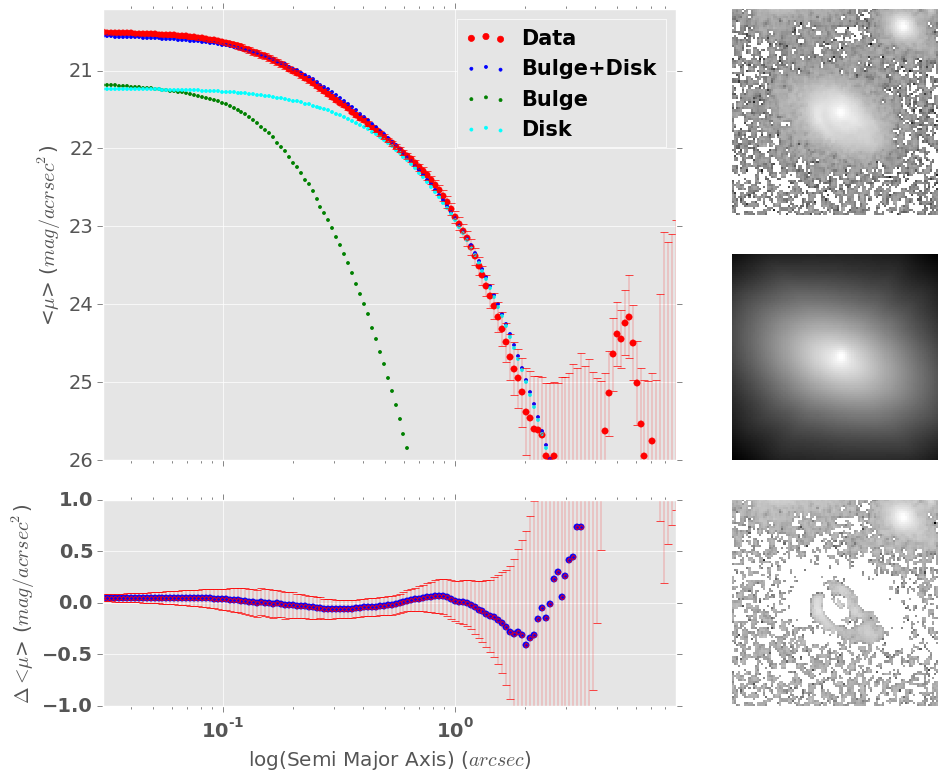

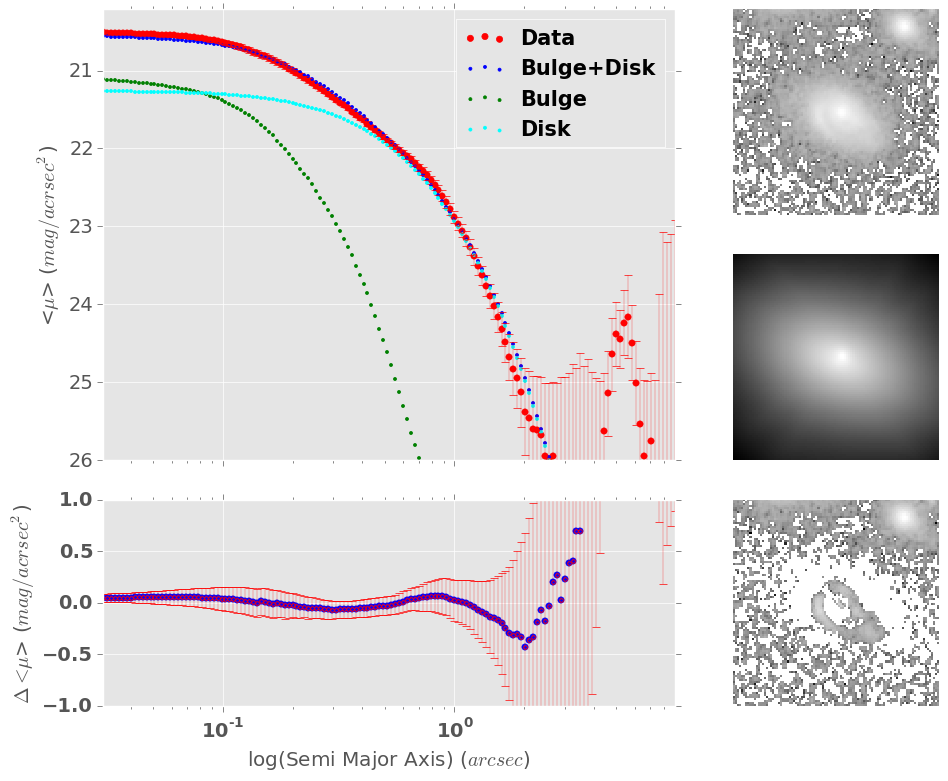

In [18]:
## For the first run only
#write_catalogue(header)
for gal in singleSer['Name']:    
    currectCat = pd.read_csv(PATH + "SM/2comp.csv")
    if gal in currectCat.Name.values:
        continue
    everyStep = raw_input('continue it or not? (yes/no): ')
    if everyStep.lower() == 'no':
        break
        
    print gal
    moveOn = raw_input('ingore this object? (yes/no): ')
    if moveOn.lower() == 'yes':
        continue
    else:
        findBest(gal)

# New Diagnostic Plots

/Users/Roozbeh/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


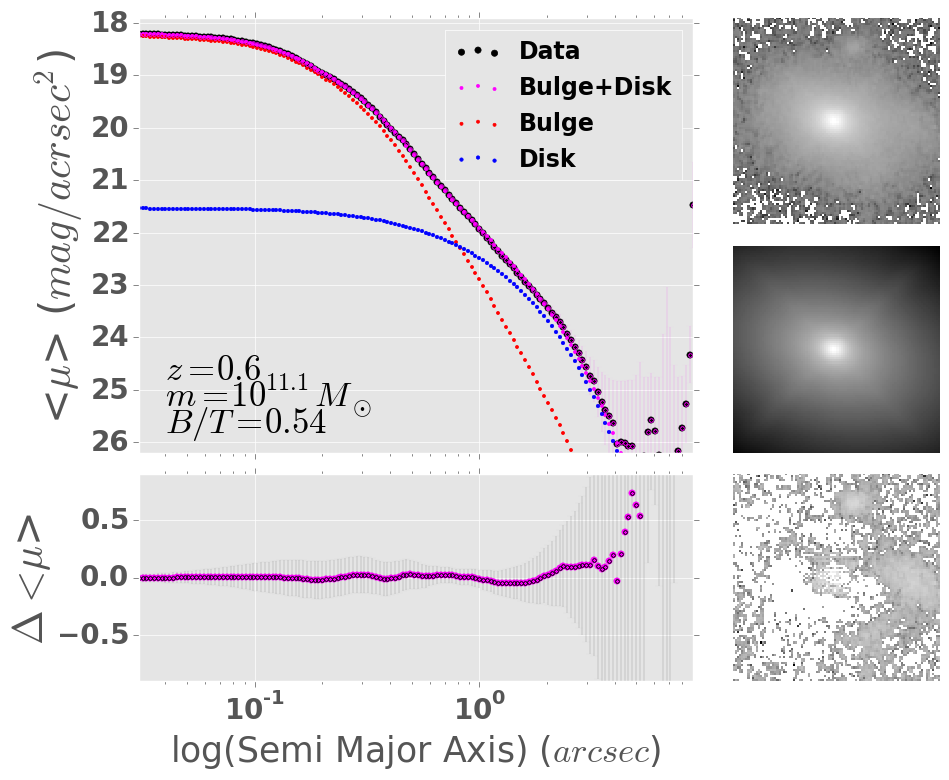

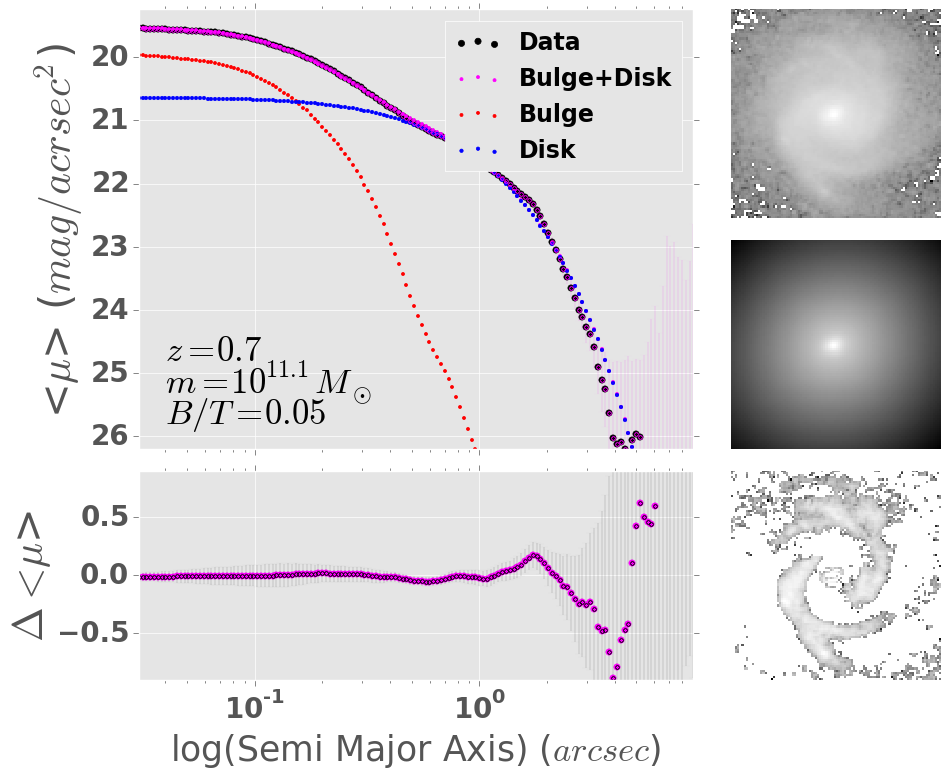

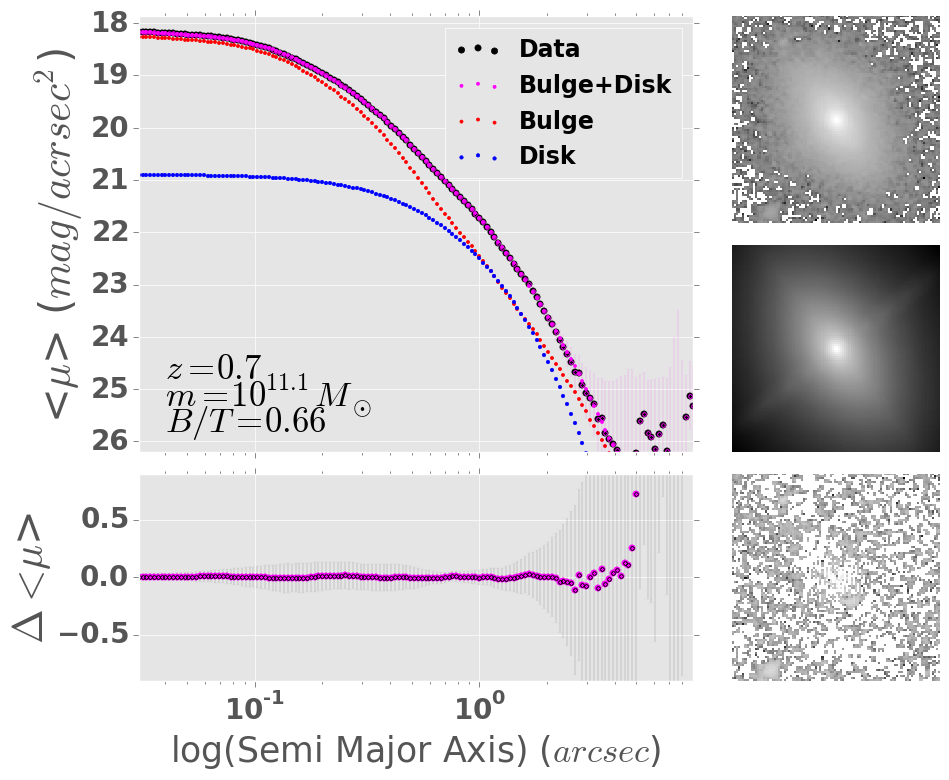

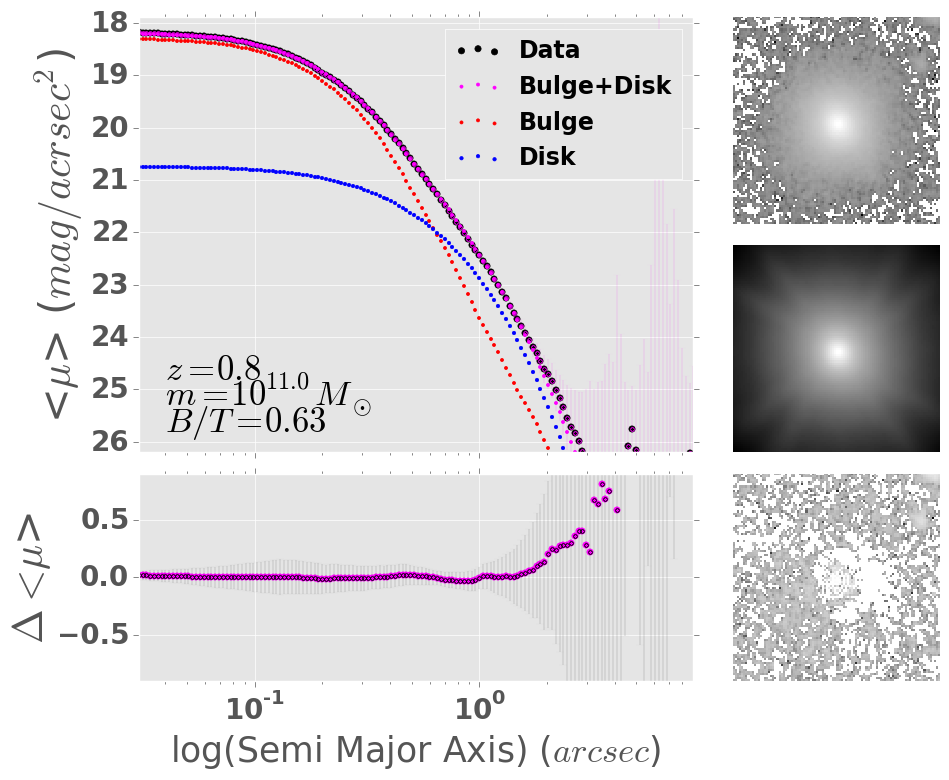

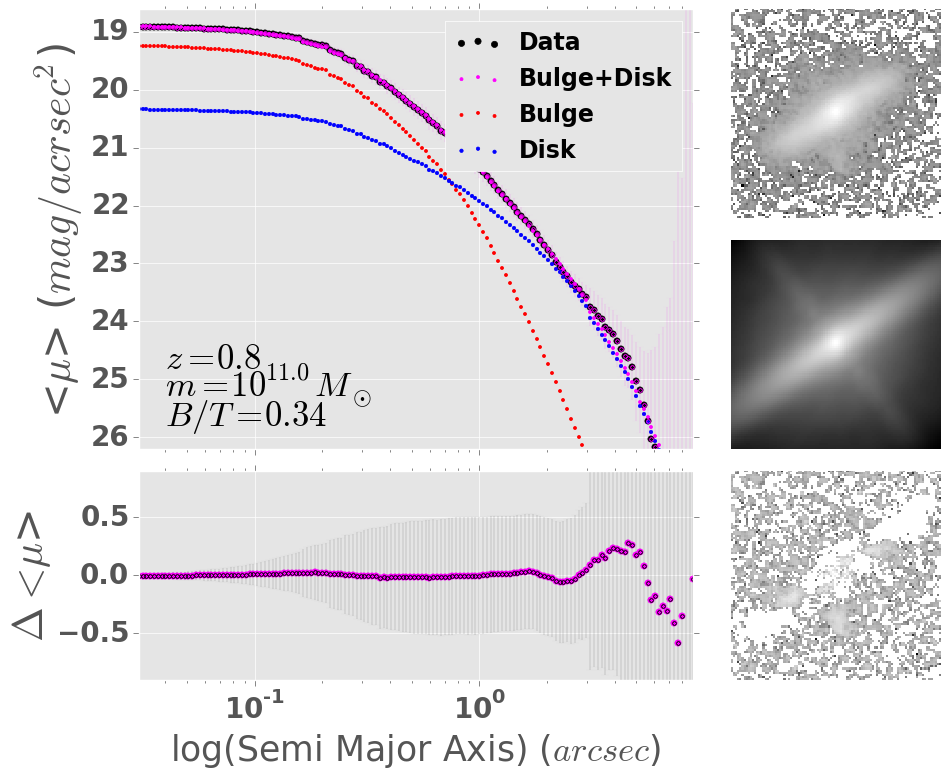

...

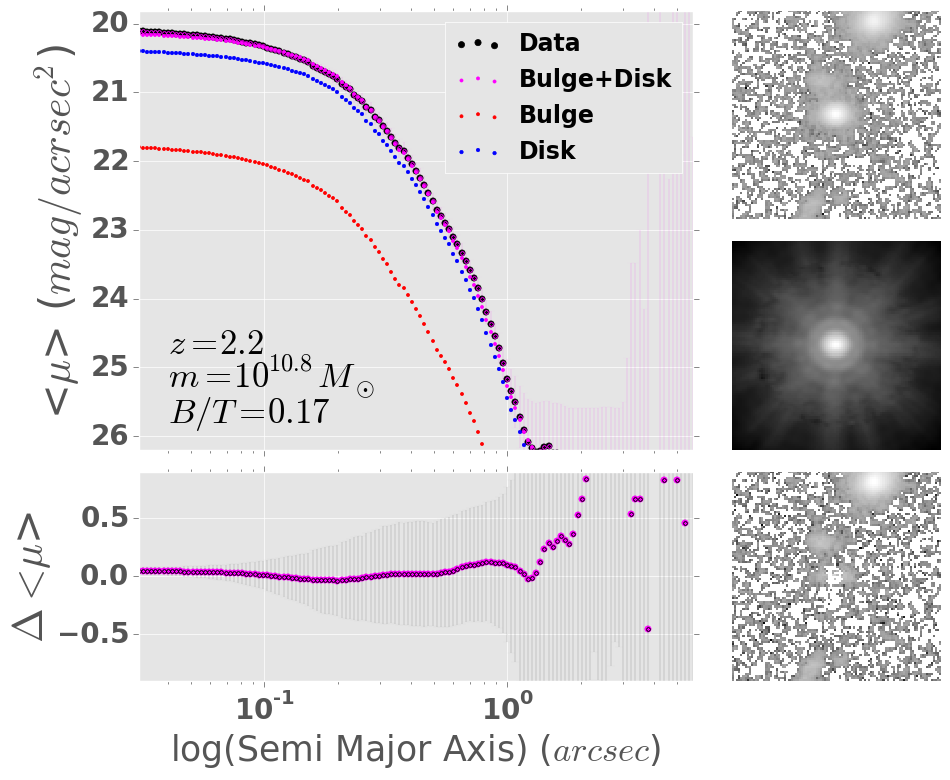

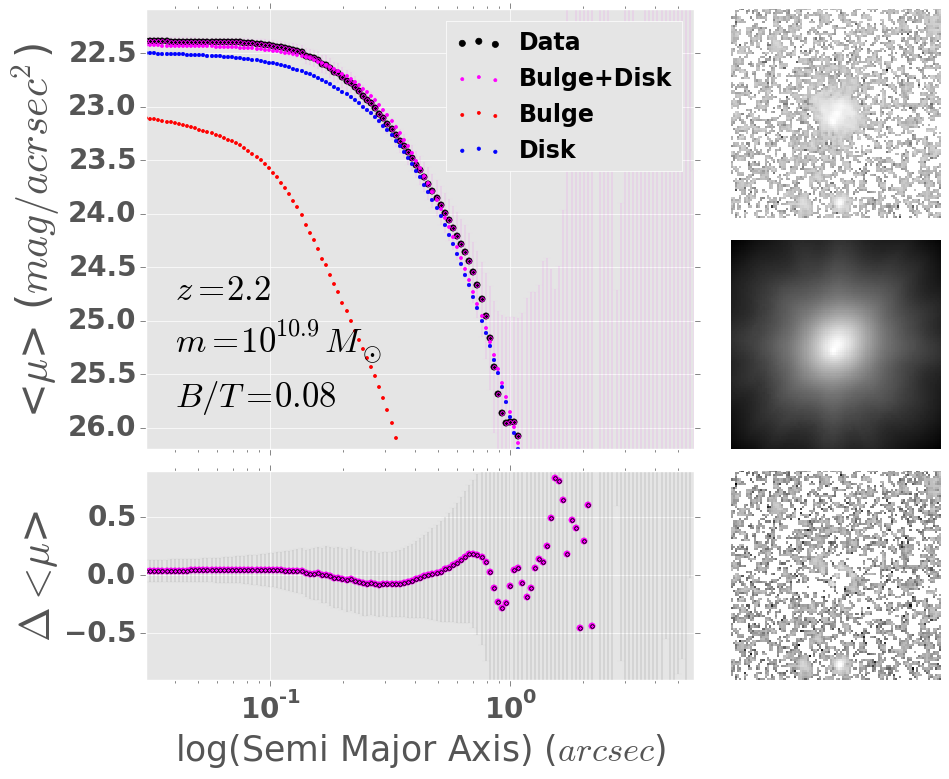

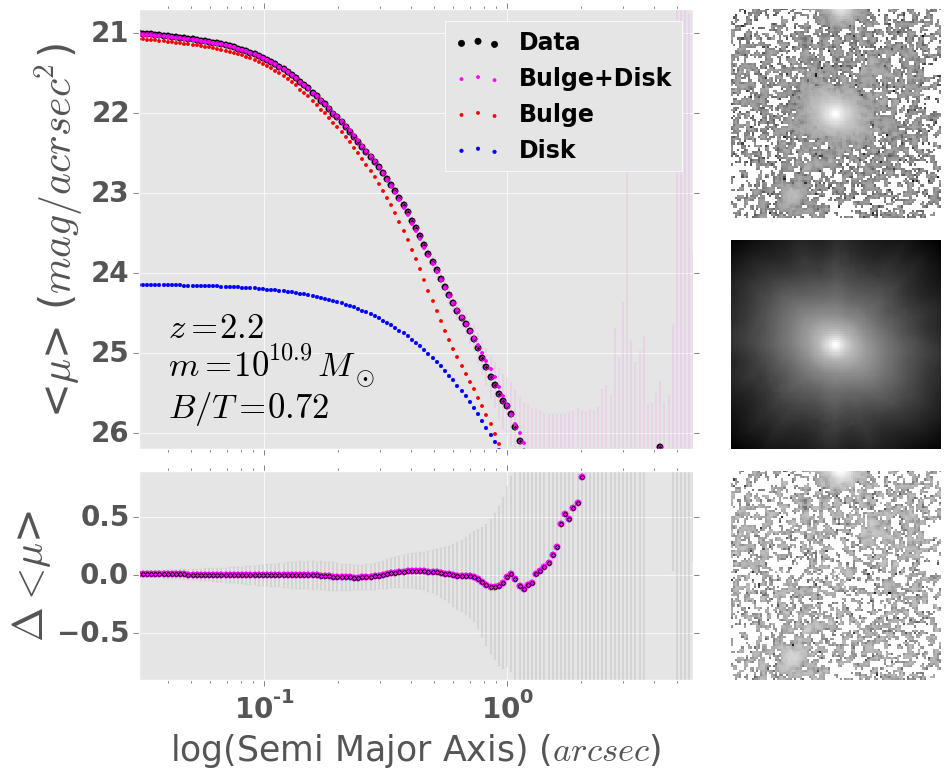

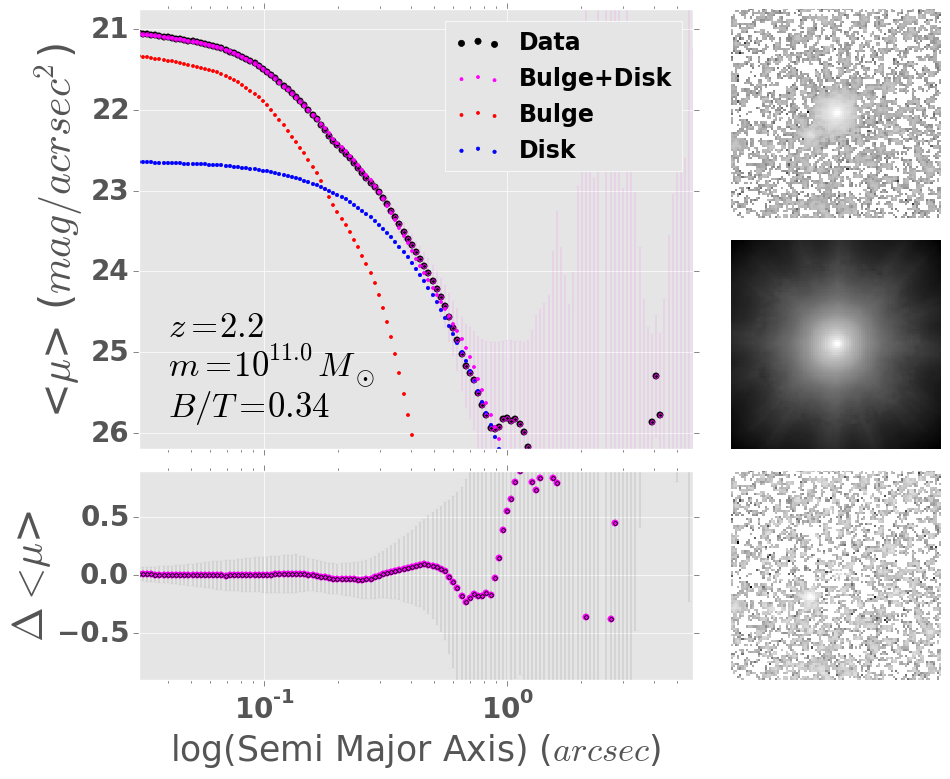

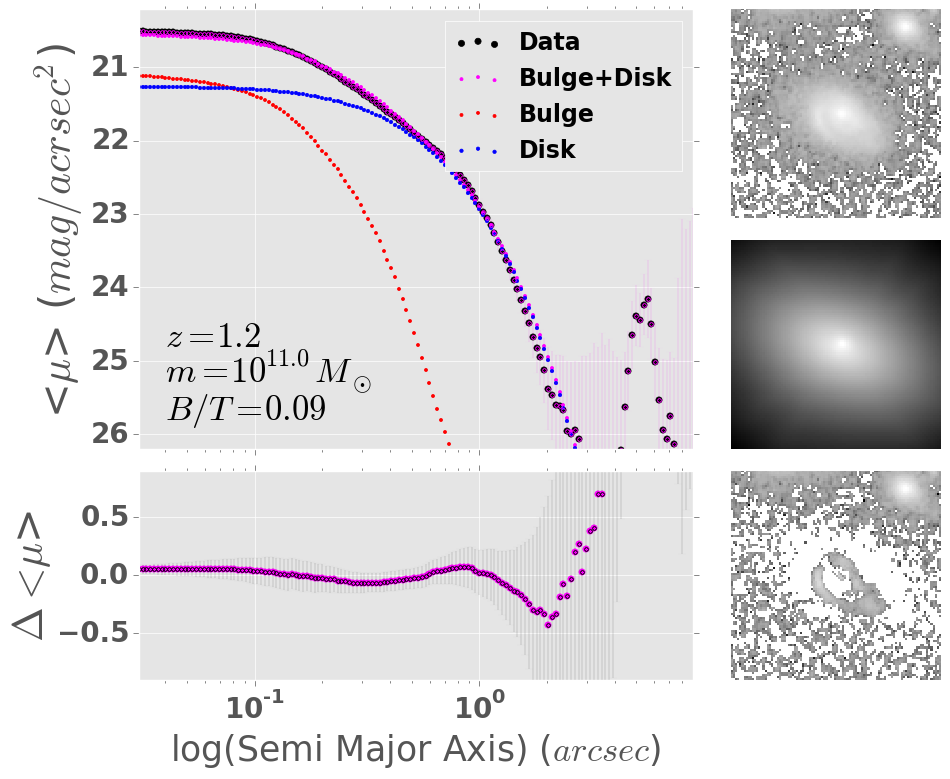

In [20]:
for Index in twoComp.index:
    
    # find the imageName
    imageName = twoComp.ix[Index].Name
    plot_diagnostic(imageName)

In [22]:
1

1